Reading img...
Loading /home/miguel/Projects/uni/data/smlm_3d/bead_3D_STORM_three_instruments/20200723_OpenFrame_3D_beads/glass_beads_agarose_1/glass_beads_agarose_1_MMStack_Default.ome.tif
Loading /home/miguel/Projects/uni/data/smlm_3d/bead_3D_STORM_three_instruments/20200723_OpenFrame_3D_beads/glass_beads_agarose_1/glass_beads_agarose_1_MMStack_Default_filtered.csv


reversing stack!!


using image sharpness
87 emitters before filtering
87 emitters after proximity filtering.
87 emitters after borders


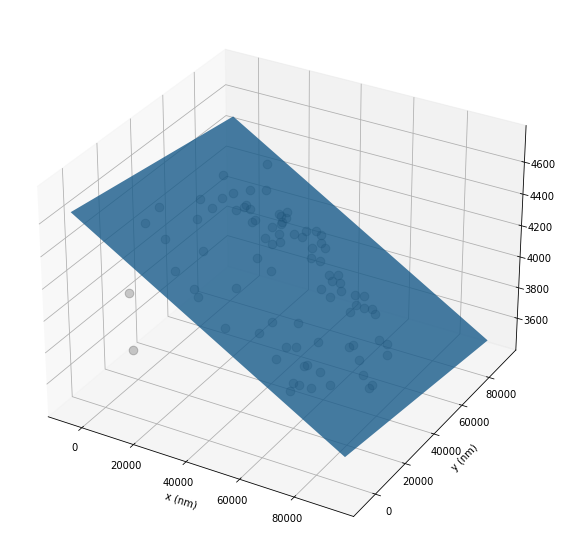

/home/miguel/Projects/uni/venv/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


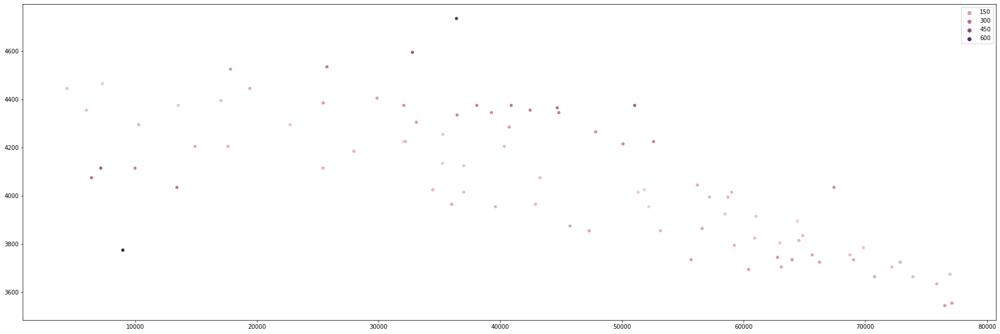

/home/miguel/Projects/uni/venv/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


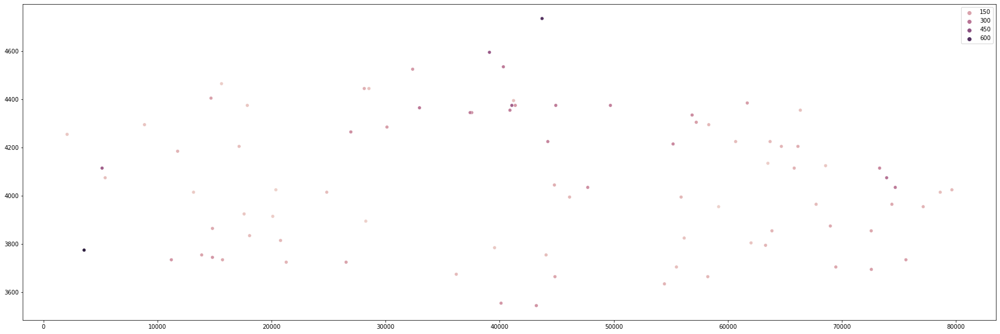

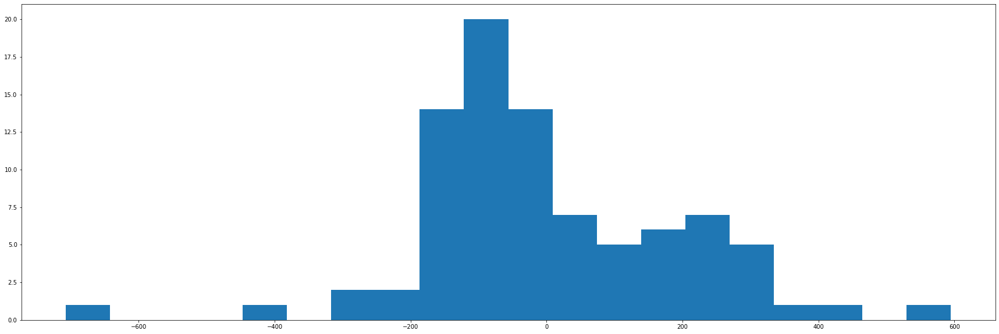

In [1]:
%load_ext autoreload
%autoreload 2
from final_project.smlm_3d.data.visualise import scatter_3d, scatter_yz, show_psf_axial, plot_with_sphere, grid_psfs
from final_project.smlm_3d.data.datasets import ExperimentalDataSet, TrainingDataSet

from final_project.smlm_3d.config.datasets import dataset_configs
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

dataset = 'openframe'
cfg = dataset_configs[dataset]['training']
# cfg['csv'] = cfg['csv'].replace('_filtered', '')
dataset = TrainingDataSet(cfg, transform_data=False, z_range=1000, add_noise=False, split_data=False, normalize_psf=False, fit_plane_z=True)

# dataset = ExperimentalDataSet(cfg, normalize_psf=False, filter_localisations=False, lazy=True)
dataset.backup_csv = dataset.csv_data.copy()

['frame', 'x [nm]', 'y [nm]', 'sigma [nm]', 'intensity [photon]', 'offset [photon]', 'bkgstd [photon]', 'chi2', 'uncertainty_xy [nm]']
(1800, 32, 32, 1)
Rows 180 Cols 10 n_spaces 1800 n_psfs 1800


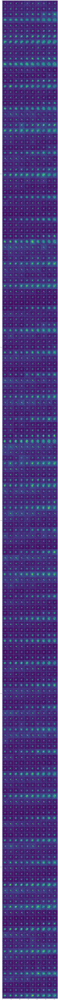

In [7]:
print(list(dataset.csv_data))
plt.rcParams['figure.figsize'] = [10, 20]
csv = dataset.csv_data

if isinstance(dataset, TrainingDataSet):
    (psfs, polar_coords), z_coords = dataset.data['all']
else:
    psfs, polar_coords = dataset.data
print(psfs.shape)
psfs = psfs.squeeze()
m = psfs.max() / 4
psfs[:, 0, :] = m
psfs[:, :, 0] = m
psfs[:, 31, :] = m
psfs[:, :, 31] = m
plt.rcParams['figure.figsize'] = [30, 300]
plt.imshow(grid_psfs(psfs))
plt.show()

In [3]:
if isinstance(dataset, TrainingDataSet):
    (psfs, polar_coords), z_coords = dataset.data['all']
else:
    psfs, polar_coords = dataset.data
print(psfs.shape)

(1800, 32, 32, 1)


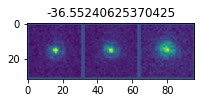

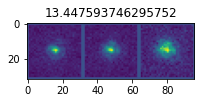

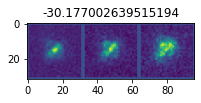

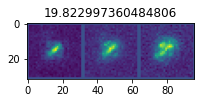

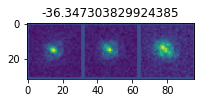

...

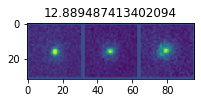

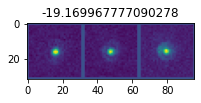

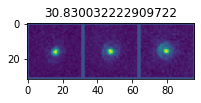

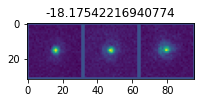

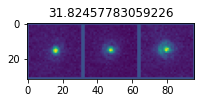

In [4]:
plt.rcParams['figure.figsize'] = [3, 5]
for i in range(psfs.shape[0]):
    if abs(z_coords[i]) < 50:
        imgs = np.concatenate((psfs[i-5], psfs[i], psfs[i+5]), axis=1)
        plt.imshow(imgs)
        plt.title(str(z_coords[i]))
        plt.show()

(90, 32, 32)
Rows 9 Cols 10 n_spaces 90 n_psfs 90
(288, 320)


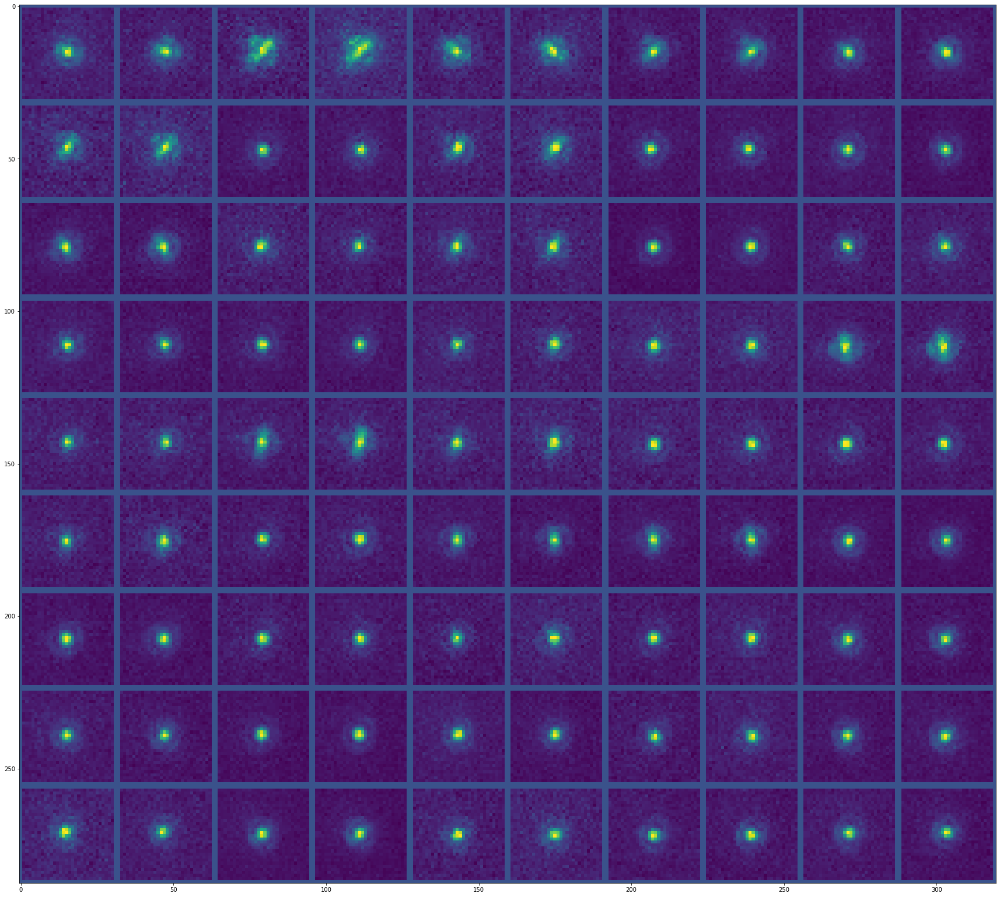

In [5]:
idx = np.argwhere(abs(z_coords) < 50)
sorted_psfs = psfs.squeeze()[idx].squeeze()
sorted_psfs = np.array([p / p.max() for p in sorted_psfs])
print(sorted_psfs.shape)
grid = grid_psfs(sorted_psfs).squeeze()
print(grid.shape)
plt.rcParams['figure.figsize'] = [30, 50]
plt.imshow(grid)
plt.show()

In [6]:
psfs, polar_coords = exp_dataset.data


NameError: name 'exp_dataset' is not defined

In [ ]:
plt.boxplot(polar_coords[:, 0])
plt.title('rho')
plt.show()
plt.boxplot(polar_coords[:, 1])
plt.title('theta')
plt.show()

In [ ]:
psfs = psfs.squeeze()
psf_mins = psfs.min(axis=(1,2))
psf_maxs = psfs.max(axis=(1,2))
plt.boxplot(psf_mins)
plt.title('mins')
plt.show()

plt.boxplot(psf_maxs)
plt.title('maxs')
plt.show()